In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import sys
import importlib
from scipy.optimize import curve_fit
from itertools import chain

from uslib import fit_functions as ff
from uslib import load_data as ld

import matplotlib.animation as animation

In [2]:
data_dir = r"O:\Tech_Photonics\Projects\Narrow Linewidth\MFB Chips\Chip 3 Feedback measurements\Measurements_2024-03-01"#r"O:\Tech_Photonics\Projects\Narrow Linewidth\MFB Chips\Chip 3 Feedback measurements\Measurements_2024-02-29"#r"O:\Tech_Photonics\Projects\Narrow Linewidth\MFB Chips\Chip 3 Feedback measurements\Measurements_2024-02-22"

data_dir1= r"O:\Tech_Photonics\Projects\Narrow Linewidth\MFB Chips\Chip 3 Feedback measurements\Measurements_2024-02-29"

data_dir2 = r"O:\Tech_Photonics\Projects\Narrow Linewidth\MFB Chips\Chip 3 Feedback measurements\Measurements_2024-02-22"

data_dir3 = r"O:\Tech_Photonics\Projects\Narrow Linewidth\MFB Chips\Chip 3 Feedback measurements\Measurements_2024-03-20" #First data entry having separate file for laser measurement

data_dir4 = r"O:\Tech_Photonics\Projects\Narrow Linewidth\MFB Chips\Chip 3 Feedback measurements\Measurements_2024-03-21"

data_dir5 = r"O:\Tech_Photonics\Projects\Narrow Linewidth\MFB Chips\Chip 3 Feedback measurements\Measurements_2024-03-26"



data_dirs = [data_dir,data_dir1,data_dir2, data_dir3, data_dir4, data_dir5]

datasets_no = len(data_dirs)

#path_coherent = r"C:\Users\au622616\OneDrive - Aarhus universitet\U shaped measurements\ESA_spectrum_Feedback measurement.txt"
dirs= []

for i in range(datasets_no):

    dirs.append(ld.get_lab_session_data(data_dirs[i]))

#ld.get_all_data()

c:\Users\au617810\.conda\envs\conda_env\Lib\site-packages\uslib\load_data.py:47: RuntimeWarning: divide by zero encountered in log10
  powers_difference_log = 10*np.log10(powers_difference_lin)


In [3]:
measurements = [[[]for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]

laser_powers = [[None for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]
laser_lists = [[[]for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]
las_var = [[None for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]

feedback_powers = [[None for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]
fb_var = [[None for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]
feedback_lists = [[[]for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]


list_of_dicts = [[{} for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]


for data_index in range(datasets_no):
    #fig, ax = plt.subplots()
    #artists = []

    #if data_index < 3:
    for i, directory in enumerate(dirs[data_index][1]): #Close spectrum is index 1

        fs = directory.freqs #Obtaining ESA close spectrum frequencies
        ps = directory.powers #Obtaining ESA close spectrum powers


        plot = False

    
        #fs, ps = dp.get_close_spectrum_from_folder(directory,plot=plot,center_about_carrier=True)

        measurements[data_index][i] = fs, ps

        list_of_dicts[data_index][i] = directory.params


        if dirs[data_index][3].las_avg[i] != None: #If there is a separate laser file

            laser_powers[data_index][i] = dirs[data_index][3].las_avg[i]
            las_var[data_index][i] = dirs[data_index][3].las_var[i]
            laser_lists[data_index][i] =  dirs[data_index][3].laser_powers[i]


        else:
            
            laser_powers[data_index][i] = list_of_dicts[data_index][i]['Laser power']
            las_var[data_index][i] = None
            



        if dirs[data_index][3].fb_avg[i] != None: #If there is a separate laser file

            feedback_powers[data_index][i] = dirs[data_index][3].fb_avg[i] #Saves the average power pr measurement
            fb_var[data_index][i] = dirs[data_index][3].fb_var[i]
            feedback_lists[data_index][i] =  dirs[data_index][3].fb_powers[i]


        else:

            feedback_powers[data_index][i] = list_of_dicts[data_index][i]['Feedback power']
            fb_var[data_index][i] = None

        
        if plot:
                
            plt.figure()
            plt.plot(fs,ps)
            plt.xlim([-0.6,0.6])
            plt.ylim([-120,-40])
            plt.xlabel('Frequency detuning [MHz]')
            plt.ylabel('Spectrum power [dBc]')
            plt.title(f'Plot number {i}')




In [4]:
no_of_pow_reads = [0 for _ in range(3,datasets_no)]

for data_index in range(3,datasets_no):
    for liste in laser_lists[data_index]:
        no_of_pow_reads[data_index-3] += len(liste)

    no_of_pow_reads[data_index-3] /= len(laser_lists[data_index])
    

In [5]:
no_of_pow_reads

[37.294117647058826, 92.17307692307692, 111.67307692307692]

In [6]:
'''with open(ld.get_all_data(data_dirs[3])[0]) as laser_file:

    laser_variances = laser_file.readlines()

    for i,directory in enumerate(dirs[data_index]):    
        las_avg = np.average(eval(laser_variances[i+1]))
        laser_powers[data_index][i] = las_avg     
        #feedback_powers[data_index][i] = list_of_dicts[data_index][i]['Feedback power']  '''

"with open(ld.get_all_data(data_dirs[3])[0]) as laser_file:\n\n    laser_variances = laser_file.readlines()\n\n    for i,directory in enumerate(dirs[data_index]):    \n        las_avg = np.average(eval(laser_variances[i+1]))\n        laser_powers[data_index][i] = las_avg     \n        #feedback_powers[data_index][i] = list_of_dicts[data_index][i]['Feedback power']  "

In [7]:
laser_powers

[[6.03114349e-05,
  6.1391409e-05,
  6.18157137e-05,
  6.14376841e-05,
  6.16078323e-05,
  6.12063086e-05,
  5.89466836e-05,
  5.98038387e-05,
  6.01170832e-05,
  5.82596876e-05,
  6.01120919e-05,
  5.85857524e-05,
  6.03164117e-05,
  5.99782616e-05,
  5.39369357e-05,
  5.99711311e-05,
  5.91631069e-05,
  5.9718408e-05,
  6.01263309e-05,
  6.00266612e-05,
  5.96763966e-05,
  6.05570422e-05,
  6.08126211e-05,
  6.02530527e-05,
  6.00458879e-05,
  5.96286991e-05,
  5.97739345e-05,
  5.98963816e-05,
  6.02594628e-05],
 [6.24023305e-05,
  6.14668679e-05,
  6.25945468e-05,
  5.88171206e-05,
  5.97362014e-05,
  6.19538259e-05,
  6.17872356e-05,
  6.23055093e-05,
  6.15971439e-05,
  6.23289961e-05,
  6.19210696e-05,
  6.31028597e-05,
  6.22165171e-05,
  5.68230425e-05,
  5.98415718e-05,
  6.10753268e-05,
  6.21816434e-05,
  6.13187949e-05,
  6.17943588e-05,
  6.03555673e-05,
  6.14426608e-05,
  6.19203711e-05,
  6.17317055e-05,
  6.15309473e-05,
  6.11970609e-05,
  6.09564231e-05,
  6.0197529

In [8]:
feedback_ratios = [[[]for _ in range(len(dirs[i][1]))] for i in range(0,datasets_no)]

for data_index in range(datasets_no):

    max_laser_power = max(laser_powers[data_index])

    for i in range(len(dirs[data_index][1])):

        laser_power = laser_powers[data_index][i]
        feedback_power = feedback_powers[data_index][i]

        feedback_ratios[data_index][i] = ld.feedback_ratio(laser_power,feedback_power,max_laser_power)

C:\Users\au617810\AppData\Local\Temp\ipykernel_21036\260460352.py:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


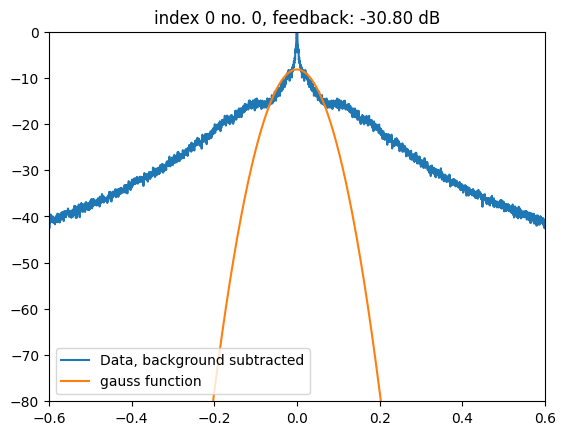

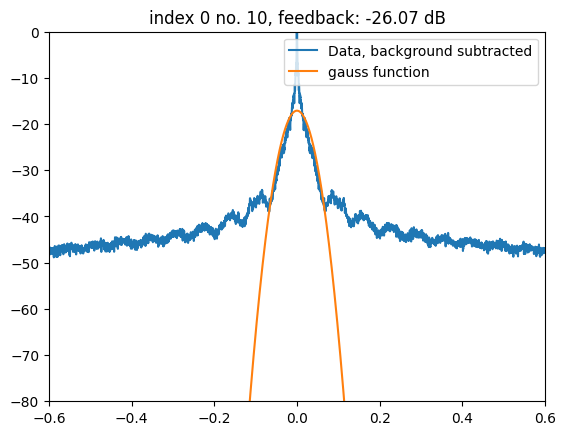

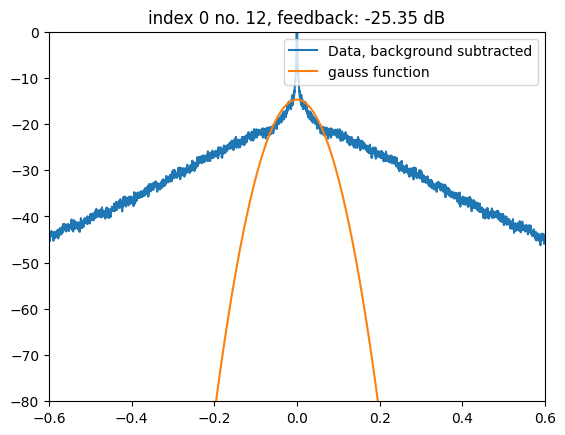

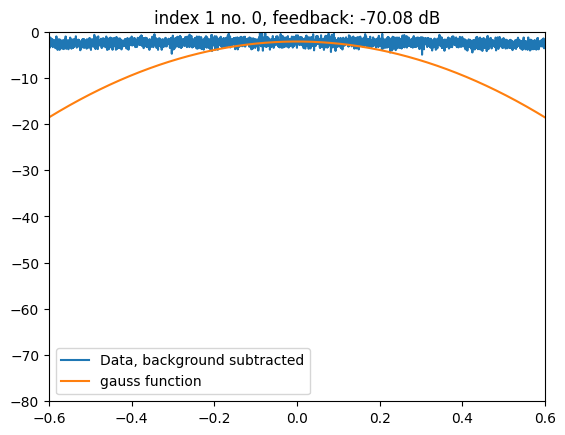

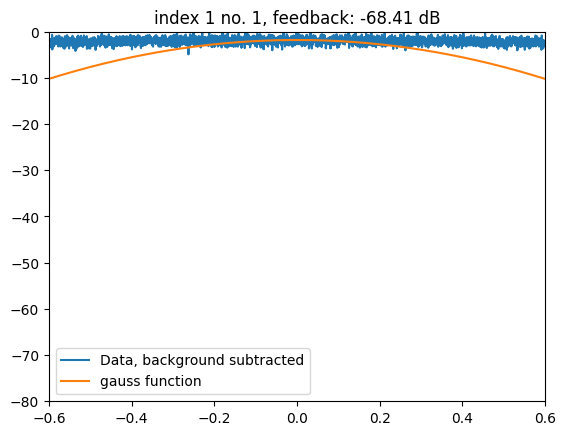

...

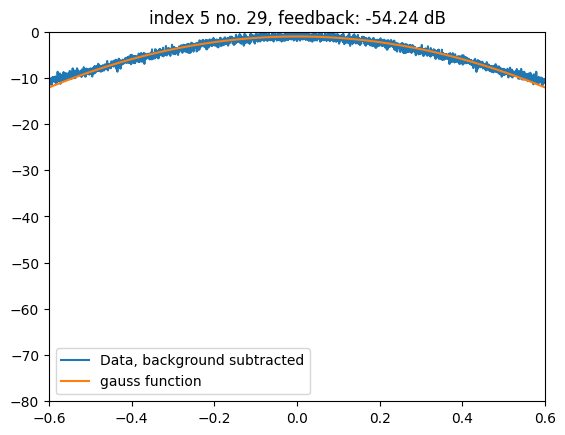

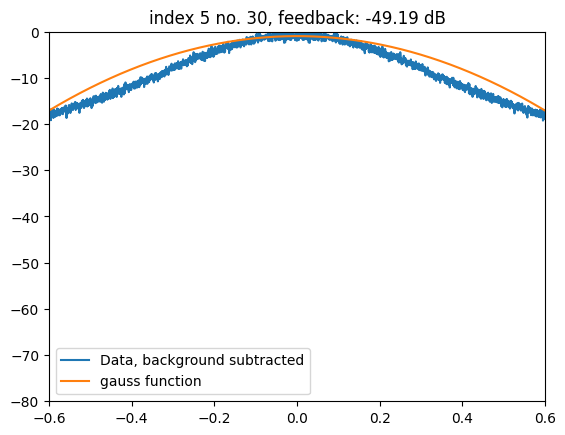

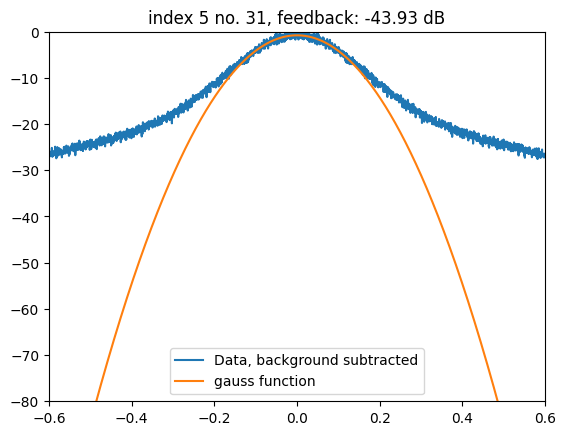

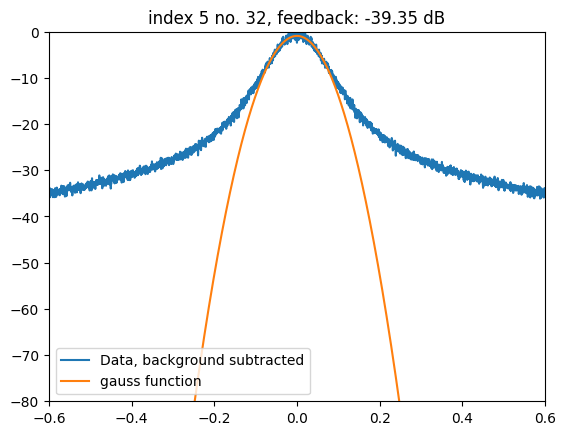

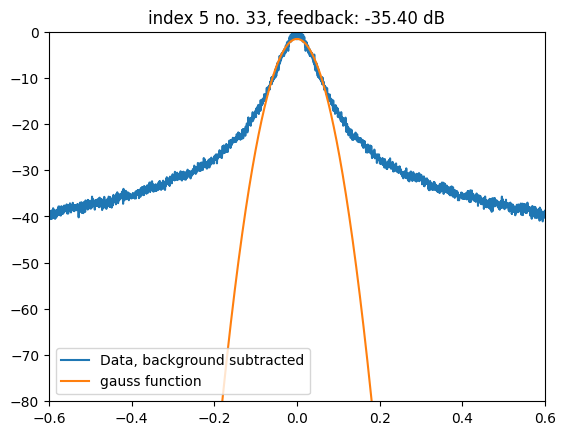

In [9]:
range_of_incoherent =  [list(range(0,1)) + list(range(10,11)) + list(range(12,13))]# + list(range(63,66))
range_of_incoherent.append(list(range(0,5)) + list(range(7,8))+ list(range(40,42)) + list(range(63,67)))
range_of_incoherent.append(list(range(0,20))+ list(range(36,38)) + list(range(41,43)))
range_of_incoherent.append(list(range(24)) + list(range(25,26)) + list(range(32,33)) + list(range(35,36)) + list(range(37,66)) + list(range(88,90)) + list(range(94,95)) + list(range(96,97)) + list(range(98,99)))
range_of_incoherent.append(list(range(13)) + list(range(19,34)) + list(range(43,49)))
range_of_incoherent.append( list(range(9)) + list(range(18,34)) )

linewidths =[[[]for _ in range(len(dirs[i][1]))] for i in range(datasets_no)]
#linewidth_lor = [[] for _ in range(3)]


for data_index in range(datasets_no):
    for number, i in enumerate(range_of_incoherent[data_index]):

        fs = measurements[data_index][i][0]
        ps = measurements[data_index][i][1] - max(measurements[data_index][i][1])
        #fs, ps = dp.get_close_spectrum_from_folder(dirs[i],plot=False,center_about_carrier=True)



        filter_close = abs(fs) < 0.075
        filter_far = (abs(fs) > 0.3) & (abs(fs) < 0.6)

        
        params_gauss, whatevs = curve_fit(ff.gauss_log,fs[filter_close]*10**6,ps[filter_close])

        #params_lor, whatevs = curve_fit(ff.lor_log,fs[filter_far]*10**6,ps[filter_far])




        #feedback_ratio = feedback_ratio_EOM_on(dirs[i])
        laser_power = laser_powers[data_index][i]
        feedback_power = feedback_powers[data_index][i]

        feedback_ratio = feedback_ratios[data_index][i]
        
        linewidths[data_index][i] = (abs(params_gauss[0])*2*np.sqrt(2*np.log(2))*np.sqrt(10/np.log(10))/np.sqrt(2)) #Divided by sqrt(2) to get linewidth from FWHM
        #linewidth_lor.append(abs(params_lor[1])) #Divided by two to get linewidth from FWHM


        #linewidths.append(params[0])



        plt.figure()
        plt.plot(fs,ps, label = 'Data, background subtracted')
        plt.plot(fs,ff.gauss_log(fs*10**6,params_gauss[0],params_gauss[1]),label='gauss function')
        #plt.plot(fs,ff.lor_log(fs*10**6,params_lor[0],params_lor[1]),label='Lorentzian function')
        plt.title(f'index {data_index} no. {i}, feedback: {feedback_ratio:.2f} dB')



        #plt.title(f'Linewidth: {params[0]*1e-3:.1f} kHz, feedback ratio: {feedback_ratio} dB, Laser power: {laser_power*1e6:.1f} µW')
        plt.legend()

        plt.xlim([-0.6,.6])
        plt.ylim([-80,0])


c:\Users\au617810\.conda\envs\conda_env\Lib\site-packages\uslib\fit_functions.py:81: RuntimeWarning: invalid value encountered in log10
  return 10*np.log10(zeta_func(freq,linewidth,time_delay(length)))+offset
C:\Users\au617810\AppData\Local\Temp\ipykernel_21036\410014875.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


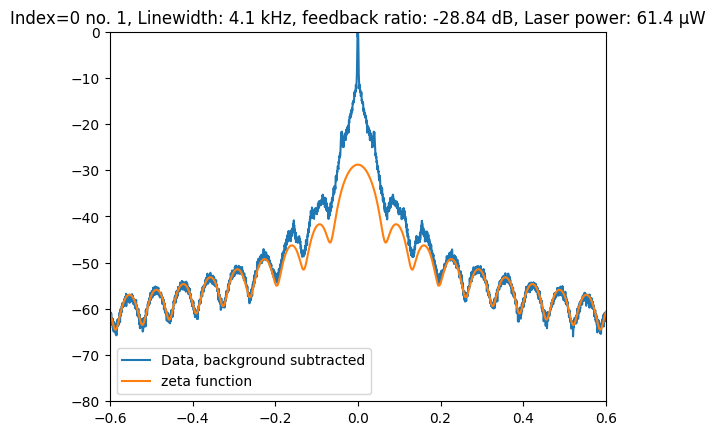

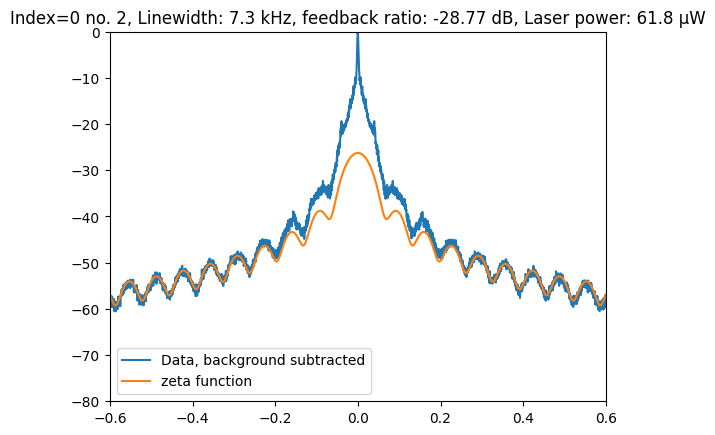

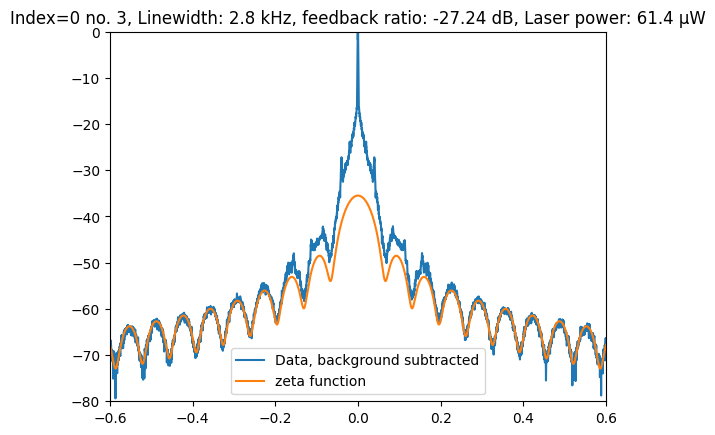

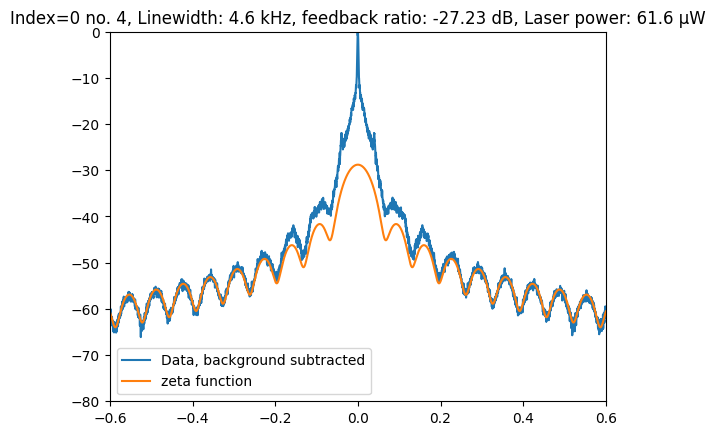

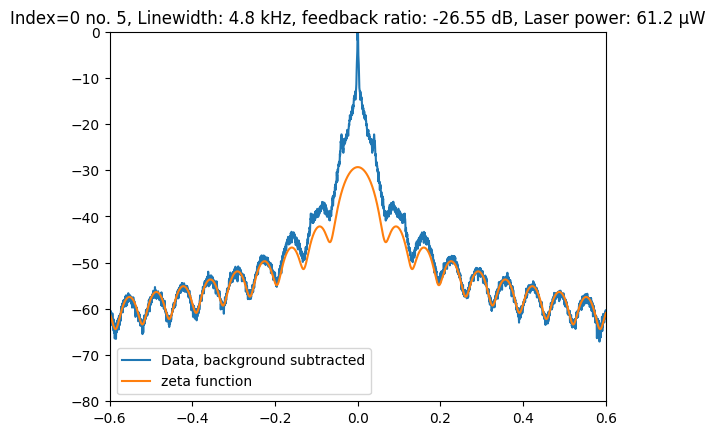

...

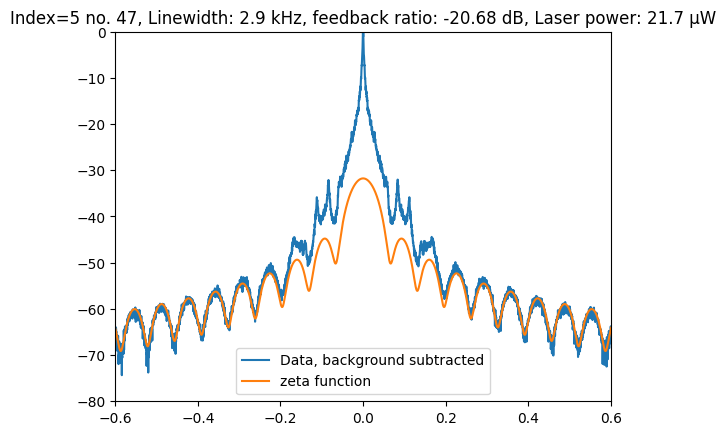

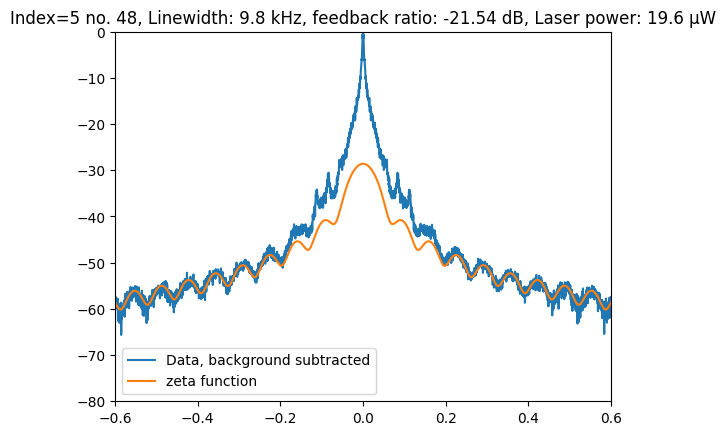

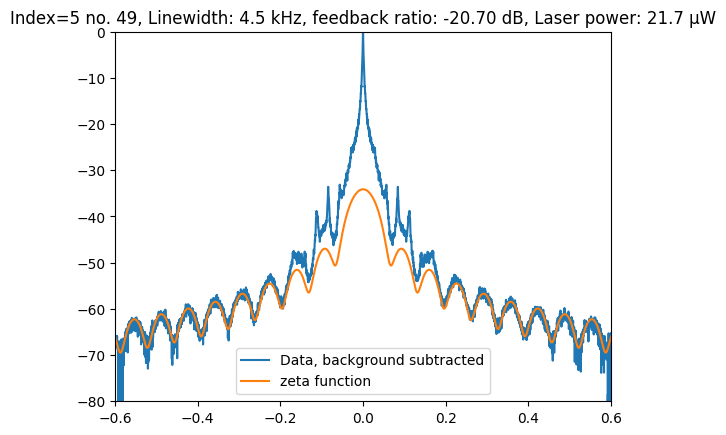

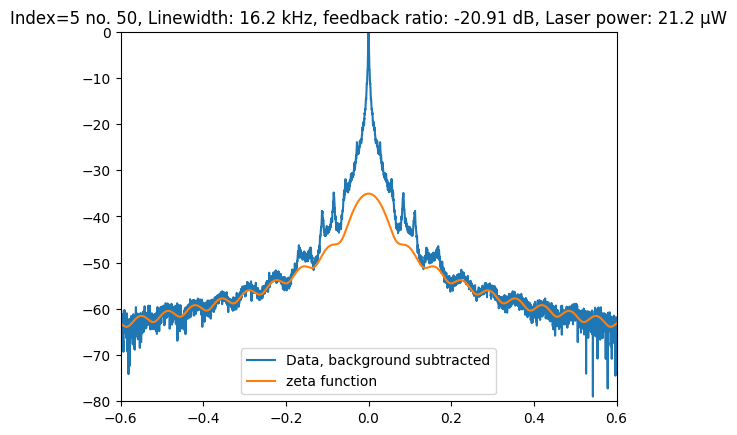

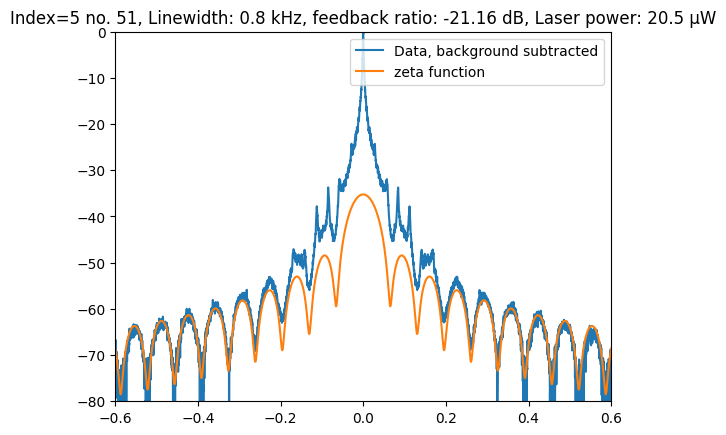

In [10]:
range_of_zeta = [list(range(1,10)) + list(range(11,12)) + list(range(13,29))] # + list(range(66,69))
range_of_zeta.append(list(range(5,7)) + list(range(8,40)) + list(range(42,63)) + list(range(67,70))) # + list(range(66,69))
range_of_zeta.append(list(range(20,36)) + list(range(38,41)))
range_of_zeta.append(list(range(24,25)) + list(range(26,32)) + list(range(33,35)) + list(range(36,37)) + list(range(66,88)) + list(range(90,94)) + list(range(95,96)) + list(range(97,98)) + list(range(99,102)))
range_of_zeta.append(list(range(13,19)) + list(range(34,43)) + list(range(49,52)))
range_of_zeta.append( list(range(9,18)) + list(range(34,52)) )


#list_of_dicts_zeta = [[{} for _ in range(len(range_of_zeta[i]))] for i in range(3)]
#linewidth_zeta= [[] for _ in range(3)]
#feedback_ratios_zeta = [[] for _ in range(3)]
#laser_powers_zeta = [[] for _ in range(3)]
#feedback_powers_zeta = [[] for _ in range(3)]


for data_index in range(datasets_no):
    for number, i in enumerate(range_of_zeta[data_index]):

        
        #fs, ps = dp.get_close_spectrum_from_folder(dirs[i],plot=False,center_about_carrier=True)

        fs = measurements[data_index][i][0]
        ps = measurements[data_index][i][1] - max(measurements[data_index][i][1])

        filter = (abs(fs) > 0.2) & (abs(fs) < 0.6)



        params, whatevs = curve_fit(ff.zeta_fit,fs[filter]*10**6,ps[filter],p0=[3*10**3,25,3140])



        linewidths[data_index][i] = params[0]
        #linewidth_lor.append(params[0])


        laser_power = laser_powers[data_index][i]
        feedback_power = feedback_powers[data_index][i]

        feedback_ratio = feedback_ratios[data_index][i]



        plt.figure()
        plt.plot(fs,ps, label = 'Data, background subtracted')
        plt.plot(fs,ff.zeta_fit(fs*10**6,params[0],params[1],params[2]), label = 'zeta function')
        plt.title(f'Index={data_index} no. {i}, Linewidth: {params[0]*1e-3:.1f} kHz, feedback ratio: {feedback_ratio:.2f} dB, Laser power: {laser_power*1e6:.1f} µW')
        plt.legend()

        plt.xlim([-.6,.6])
        plt.ylim([-80,0])

            

In [16]:
list0= [[1,2,3],[4,5,6]]
list1= [[7,8],[1,6]]

a = {'laser':[list0,list1]}


In [19]:
a = {}

In [21]:
if not a:
    print(i)

43


In [18]:
a['laser']

[[[1, 2, 3], [4, 5, 6]], [[7, 8], [1, 6]]]

c:\Users\au617810\.conda\envs\conda_env\Lib\site-packages\uslib\fit_functions.py:81: RuntimeWarning: invalid value encountered in log10
  return 10*np.log10(zeta_func(freq,linewidth,time_delay(length)))+offset


Linewidth: 568.193750777336, offset: 26.182054126458713, delay length: 3137.614871932716


c:\Users\au617810\.conda\envs\conda_env\Lib\site-packages\uslib\fit_functions.py:81: RuntimeWarning: invalid value encountered in log10
  return 10*np.log10(zeta_func(freq,linewidth,time_delay(length)))+offset


Linewidth: 933.7666131770388, offset: 23.072442288204105, delay length: 3134.9055347792078
Linewidth: 2586.8736630673393, offset: 22.179514064922692, delay length: 3133.866253641054


c:\Users\au617810\.conda\envs\conda_env\Lib\site-packages\uslib\fit_functions.py:81: RuntimeWarning: invalid value encountered in log10
  return 10*np.log10(zeta_func(freq,linewidth,time_delay(length)))+offset


Linewidth: 978.3610051109617, offset: 30.517469412677126, delay length: 3135.3647496840554
Linewidth: 1665.0963100119648, offset: 21.441295983337675, delay length: 3137.703369787596


c:\Users\au617810\.conda\envs\conda_env\Lib\site-packages\uslib\fit_functions.py:81: RuntimeWarning: invalid value encountered in log10
  return 10*np.log10(zeta_func(freq,linewidth,time_delay(length)))+offset


Linewidth: 689.0083636293019, offset: 29.152016358461612, delay length: 3134.5510371774258


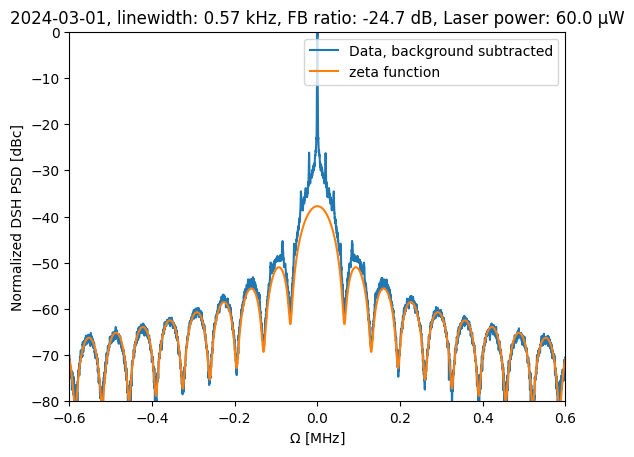

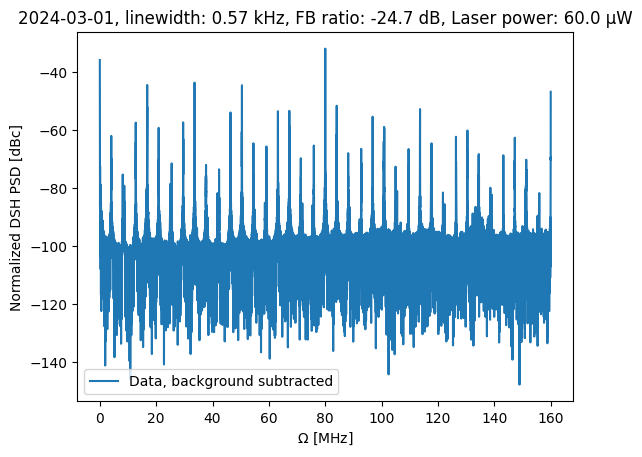

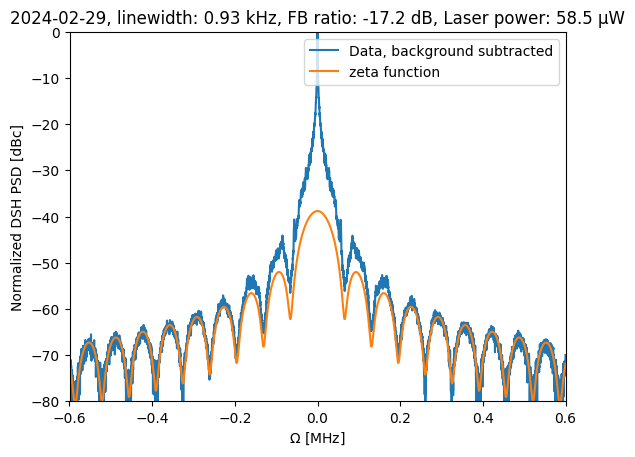

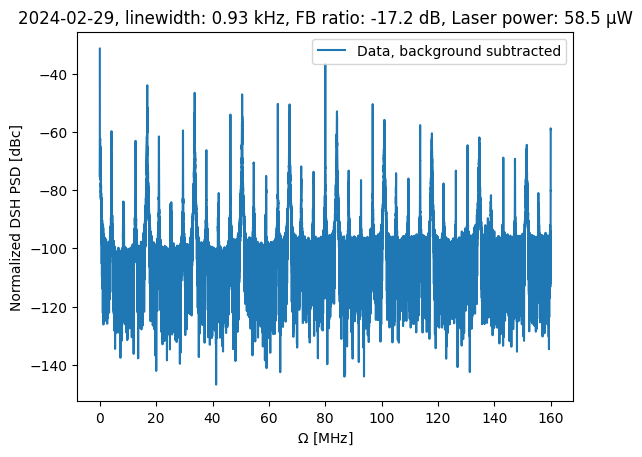

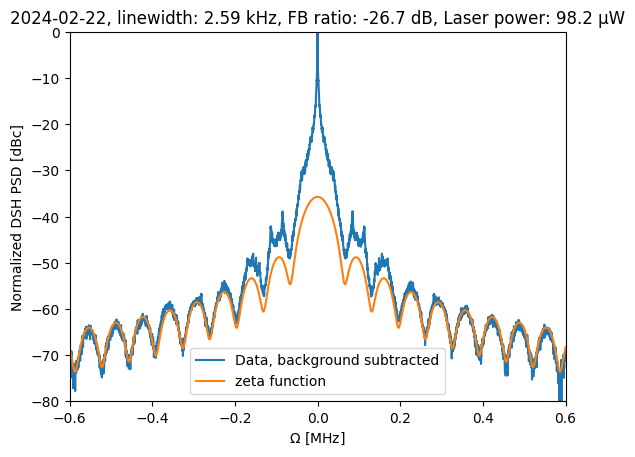

...

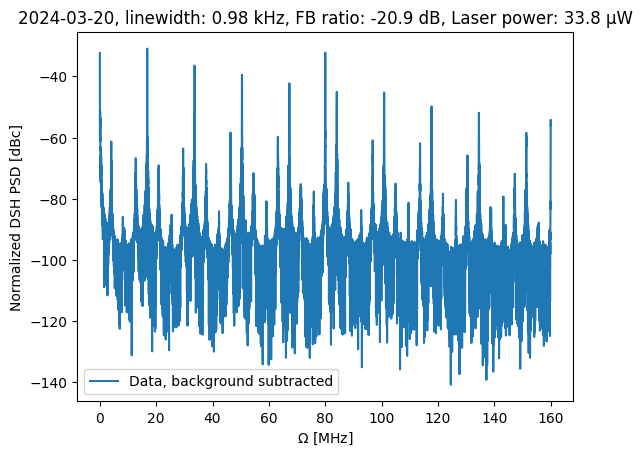

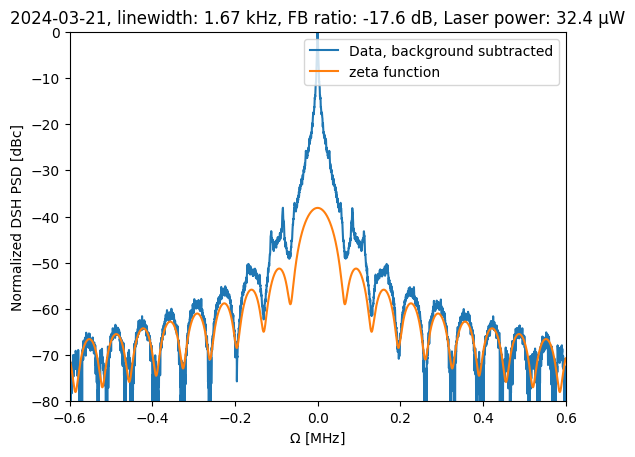

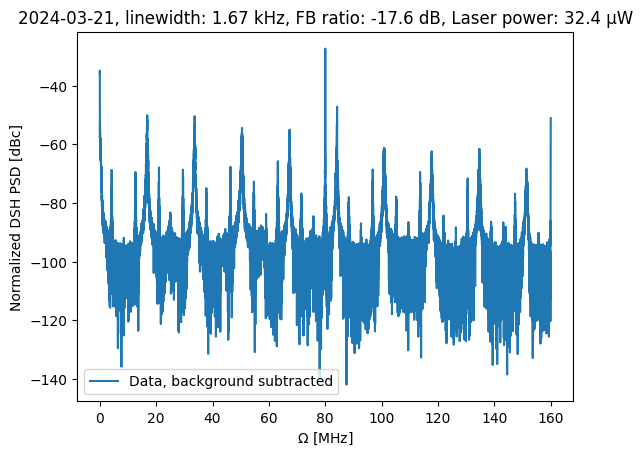

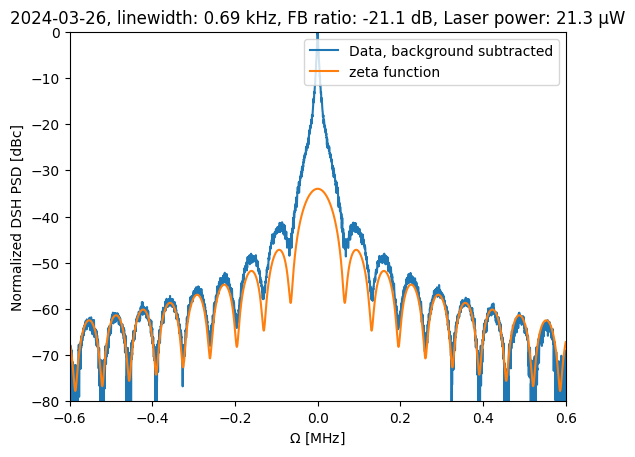

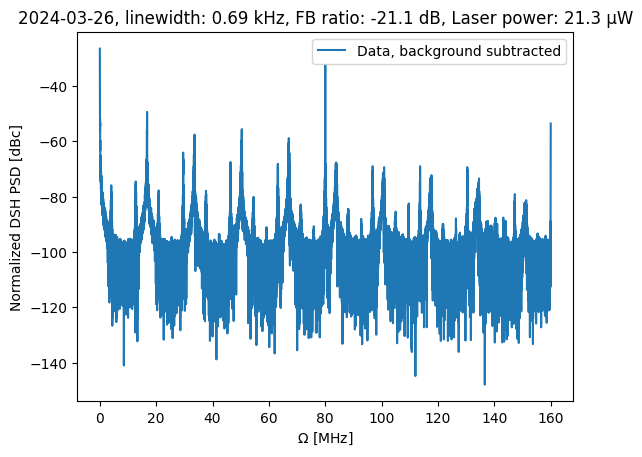

In [12]:
#Saving the plots with the lowest linewidths

for data_index in range(datasets_no):

    i = linewidths[data_index].index(min(linewidths[data_index]))

    fs = measurements[data_index][i][0]
    ps = measurements[data_index][i][1] - max(measurements[data_index][i][1])

    filter = (abs(fs) > 0.2) & (abs(fs) < 0.6)

    params, whatevs = curve_fit(ff.zeta_fit,fs[filter]*10**6,ps[filter],p0=[3*10**3,25,3140])

    print(f'Linewidth: {params[0]}, offset: {params[1]}, delay length: {params[2]}')


    linewidths[data_index][i] = params[0]
    #linewidth_lor.append(params[0])


    laser_power = laser_powers[data_index][i]
    feedback_power = feedback_powers[data_index][i]

    feedback_ratio = feedback_ratios[data_index][i]


    plt.figure()
    plt.plot(fs,ps, label = 'Data, background subtracted')
    plt.plot(fs,ff.zeta_fit(fs*10**6,params[0],params[1],params[2]), label = 'zeta function')
    plt.title(fr'{data_dirs[data_index][96:]}, linewidth: {params[0]*1e-3:.2f} kHz, FB ratio: {feedback_ratio:.1f} dB, Laser power: {laser_power*1e6:.1f} µW')
    plt.legend()

    plt.xlim([-.6,.6])
    plt.ylim([-80,0])

    plt.xlabel(r'$\Omega$ [MHz]')
    plt.ylabel(r'Normalized DSH PSD [dBc]')
    
    plt.savefig(fr'.\Measurement spectra and plots\Linewidths\{data_dirs[data_index][96:]}_ESA_spectrum_zeta_fit_low_linewidth_best.pdf')
    plt.savefig(fr'.\Measurement spectra and plots\Linewidths\{data_dirs[data_index][96:]}_ESA_spectrum_zeta_fit_low_linewidth_best.png')




    fs_full = dirs[data_index][0][i].freqs 
    ps_full = dirs[data_index][0][i].powers

    plt.figure()
    plt.plot(fs_full,ps_full, label = 'Data, background subtracted')
    #plt.plot(fs_full,ff.zeta_fit(fs*10**6,params[0],params[1],params[2]), label = 'zeta function')
    plt.title(fr'{data_dirs[data_index][96:]}, linewidth: {params[0]*1e-3:.2f} kHz, FB ratio: {feedback_ratio:.1f} dB, Laser power: {laser_power*1e6:.1f} µW')
    plt.legend()

    #plt.xlim([-.6,.6])
    #plt.ylim([-80,0])

    plt.xlabel(r'$\Omega$ [MHz]')
    plt.ylabel(r'Normalized DSH PSD [dBc]')
    
    plt.savefig(fr'.\Measurement spectra and plots\Linewidths\{data_dirs[data_index][96:]}_ESA_full_spectrum_low_linewidth_best.pdf')
    plt.savefig(fr'.\Measurement spectra and plots\Linewidths\{data_dirs[data_index][96:]}_ESA_full_spectrum_low_linewidth_best.png')


In [ ]:
def R_squared(data,fitfunc_evaluated): #Goodness of fit
    
    return (((data-fitfunc_evaluated))**2).sum()/len(data) #/ ((data-data.mean())**2).sum()

In [ ]:
xs  = np.arange(-70,-40,0.1)
x_zeta = np.arange(-38,-15,0.1)

def fitfunc(xs,a,b):
    
    return a*xs+b

In [ ]:
params_zeta = [[] for _ in range(datasets_no)]
for i in range(datasets_no):
        
    plt.figure()
    param_zeta, whatevs_zeta = curve_fit(fitfunc,np.array(feedback_ratios[i])[range_of_zeta[i]],10*np.log10(np.array(linewidths[i])[range_of_zeta[i]]))

    params_zeta[i] = param_zeta

    plt.plot(np.array(feedback_ratios[i])[range_of_zeta[i]],10*np.log10(np.array(linewidths[i])[range_of_zeta[i]]),'.')
    #plt.plot(xs,fitfunc(xs,params_lin[0],params_lin[1]))

    #plt.plot(feedback_ratios_zeta,10*np.log10(np.array(linewidth_zeta)),'.')
    plt.plot(x_zeta,fitfunc(x_zeta,params_zeta[i][0]-0.3,params_zeta[i][1]-7))

    plt.title(f'Linear fit, {data_dirs[i][96:]}, fitted slope - 0.3: {params_zeta[i][0] - 0.3:.2f}')
    plt.xlabel('Feedback ratio [dB]')
    plt.ylabel('Linewidth [dB]?')

    plt.savefig(fr'.\Measurement spectra and plots\Linewidths\Linewidth vs feedback ratio lin fit {data_dirs[i][96:]}.png')
    plt.savefig(fr'.\Measurement spectra and plots\Linewidths\Linewidth vs feedback ratio lin fit {data_dirs[i][96:]}.pdf')

In [ ]:

plt.figure()

for data_index in range(datasets_no):


    if data_index == 1:
        plt.plot(feedback_ratios[data_index], linewidths[data_index], '.', label = f'Gaussian, zeta fit, {data_dirs[data_index][96:]}, log avg')
        #plt.plot(feedback_ratios,np.array(linewidth_lor),'.', label = 'Lorentzian fit')

    else: 
        plt.plot(feedback_ratios[data_index], linewidths[data_index], '.', label = f'Gaussian, zeta fit, {data_dirs[data_index][96:]}')
        #plt.plot(np.array(feedback_ratios[data_index])[range_of_incoherent[data_index]], linewidth_gauss[data_index], '.', label = f'Gaussian fit, {data_dirs[data_index][96:]}')
        #plt.plot(feedback_ratios,np.array(linewidth_lor),'.', label = 'Lorentzian fit')
        #plt.plot(np.array(feedback_ratios[data_index])[range_of_zeta[data_index]], linewidth_zeta[data_index],'.', label = f'Zeta fit, {data_dirs[data_index][96:]}')

    plt.title('Feedback ratio vs linewidth')
    plt.xlabel('Feedback ratio [dB]')
    plt.ylabel('Linewidth [Hz]')
    #plt.plot(xs,np.exp(fitfunc(xs,params_lin[0]))
    plt.ylim([4*10**2,10**7])
    plt.yscale('log')

    plt.legend(loc='lower left')
    plt.xlim([-71,-15])
    plt.savefig(fr'.\Measurement spectra and plots\Linewidths\Linewidth vs feedback ratio.png')
    plt.savefig(fr'.\Measurement spectra and plots\Linewidths\Linewidth vs feedback ratio.pdf')

In [ ]:
plt.plot(np.linspace(-0.6*10**6,0.6*10**6,10**3)*10**(-6), ff.zeta_fit(np.linspace(-0.6*10**6,0.6*10**6,10**3),6*10**4,0,3140))


plt.title(r'$\zeta$ function, 3140m delay, 60kHz linewidth')
plt.xlabel(r'$\Omega$ [MHz]')
plt.ylabel(r'$\zeta(\Omega)$ [Arb. units]')
#plt.plot(xs,np.exp(fitfunc(xs,params_lin[0]))
#plt.ylim([4*10**2,10**7])

#plt.legend(loc='lower left')
#plt.xlim([-71,-15])
plt.savefig(fr'.\Measurement spectra and plots\Linewidths\Zeta_func_60kHz_linewidth.png')
plt.savefig(fr'.\Measurement spectra and plots\Linewidths\Zeta_func_60kHz_linewidth.pdf')

In [ ]:
for i in range(20):

    if i==12:
        break
    print(i)


print('whatevs')

In [ ]:
import os


In [ ]:
path_aux = os.path.join(os.getcwd(),'meas')

In [ ]:
path_aux

In [ ]:
a = [[1,5],[2,6],[4,5]]
b = [[1,2],[26,27],[6,7]]

np.savetxt('gg.txt',a,fmt='%s')

In [ ]:
print(f'The largest difference in feedback ratio calculation is {max(abs(10*np.log10(np.divide(np.array(feedback_powers),np.array(laser_powers)*40))-np.array(feedback_ratios))):.2f} dB')

In [ ]:
freq = np.linspace(-10**6,10**6,10**7)


plt.plot(freq, ff.zeta_fit(freq,1*10**4,0,500))

In [ ]:
test = np.array([5,4])
print(test**2)